# Color Transfer Between Images

Imports

In [1]:
import numpy as np
import cv2
import os
import math
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
from PIL import Image

Funtion for reading images

In [2]:
def read_image(sn,tn):
    source = cv2.imread('data/'+sn+'.png')
    #converting image RGB to lab colorspace
    source = cv2.cvtColor(source, cv2.COLOR_BGR2LAB) 
    target = cv2.imread('data/'+tn+'.png')
    target = cv2.cvtColor(target ,cv2.COLOR_BGR2LAB)
    return source, target

Compute means (µl, µα, µβ) and standard deviations (σl, σα, σβ).

In [3]:
def get_mean_std(point):
    p_mean, p_std = cv2.meanStdDev(point)
    p_mean = np.hstack(np.around(p_mean,2))
    p_std = np.hstack(np.around(p_std,2))
    return p_mean, p_std

In [4]:
def histogram(image):
    # green color replaced with yellow to see clearly because im red-green colorblind :(
    for i, col in enumerate(['b', 'y', 'r']): #replace "y" with "g"
        hist = cv2.calcHist([image], [i], None, [256], [0, 256])
        plt.plot(hist, color = col)
        plt.xlim([0, 256])
        
    #plt.rcParams['figure.figsize'] = [12, 8]

    plt.show()

Color transfer using Reinhard et al

In [5]:
sources = ['in_01','in_02','in_03','in_05','in_06','in_08','in_09','in_11','in_15','in_20','in_24','in_29','in_50','in_51','in_56']
targets = ['tar_01','tar_02','tar_03','tar_05','tar_06','tar_08','tar_09','tar_11','tar_15','tar_20','tar_24','tar_29','tar_50','tar_51','tar_56']


def color_transfer():
    
    for n in range(len(sources)):
        print("Converting picture "+ str(n+1) + "...")
        s, t = read_image(sources[n],targets[n])
        
        source_bgr = cv2.cvtColor(s,cv2.COLOR_LAB2BGR)
        source_rgb = cv2.cvtColor(s,cv2.COLOR_LAB2RGB)
        img_source = Image.fromarray(source_rgb)
        display(img_source)
        histogram(source_bgr)
        
        s_mean, s_std = get_mean_std(s)
        t_mean, t_std = get_mean_std(t)
        
        height, width, channel = s.shape
        for i in range(0,height):
            for j in range(0,width):
                for k in range(0,channel):
                    
                    point = s[i,j,k]
                    point = ((point-s_mean[k])*(t_std[k]/(s_std[k]+0.00001)))+t_mean[k]                    
                    point = round(point)
                    
                    if(point<0):
                        point = 0
                    elif(point>255):
                        point = 255
                    
                    s[i,j,k] = point
                    
        s = cv2.cvtColor(s,cv2.COLOR_LAB2BGR)
        s_rgb = cv2.cvtColor(s,cv2.COLOR_BGR2RGB)
        img = Image.fromarray(s_rgb)
        display(img)
        histogram(s)
        cv2.imwrite('results_pt1/r'+str(n+1)+'.png',s)

Converting picture 1...


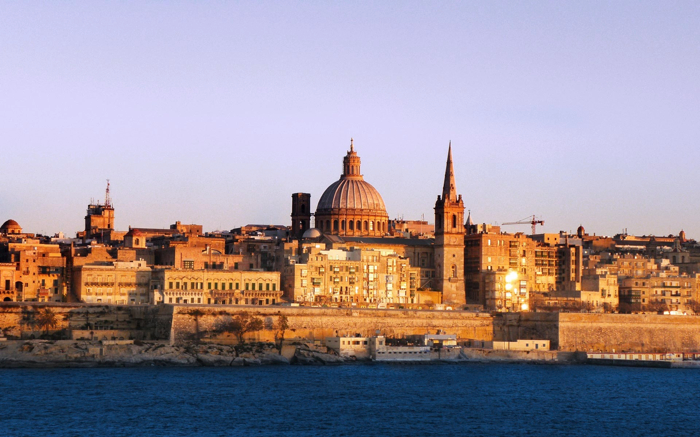

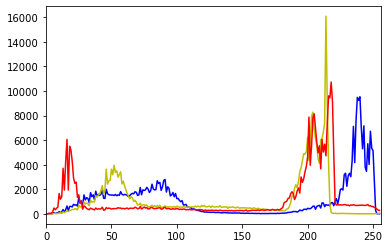

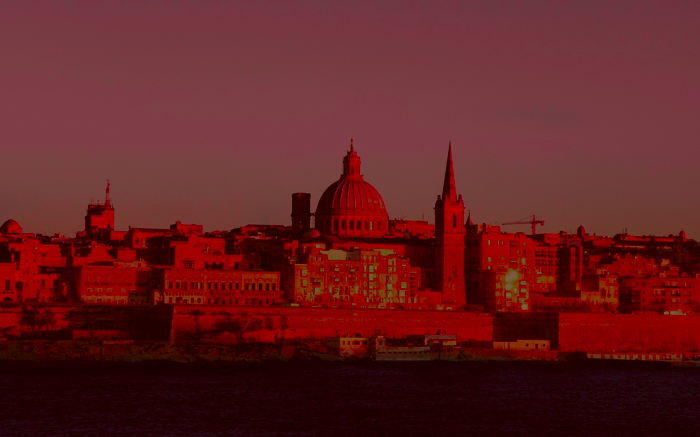

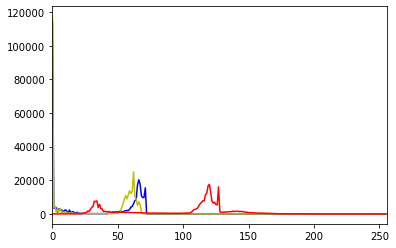

Converting picture 2...


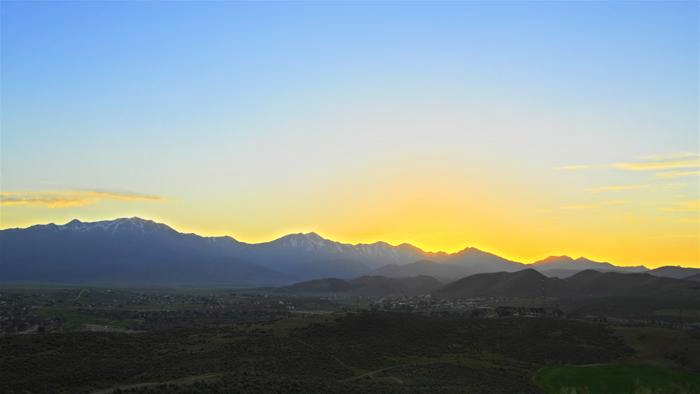

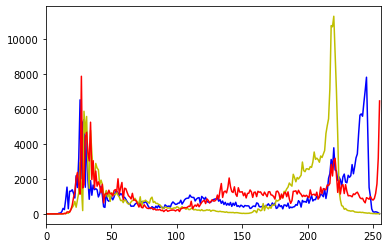

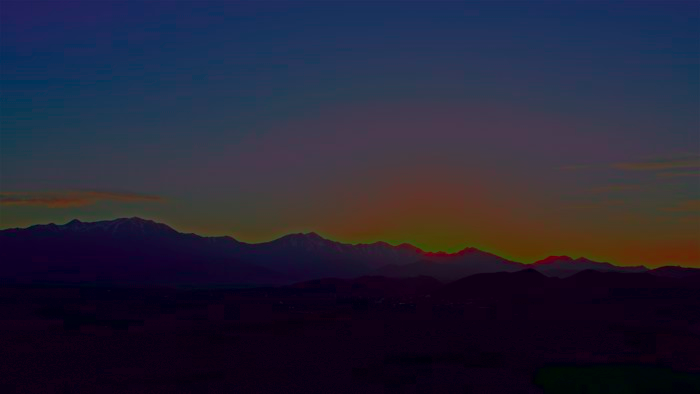

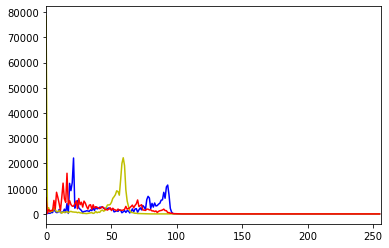

Converting picture 3...


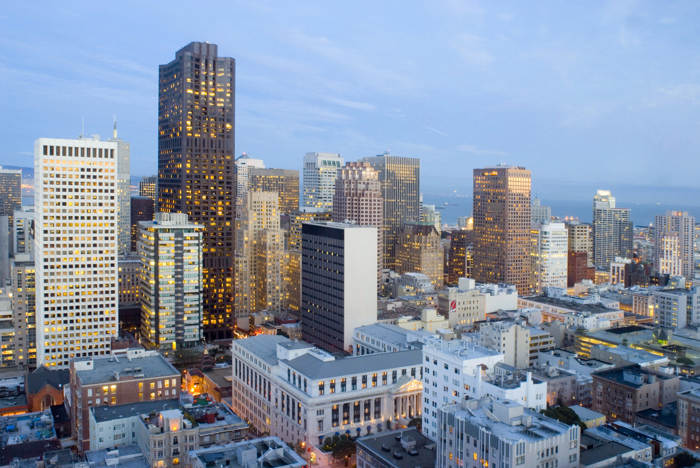

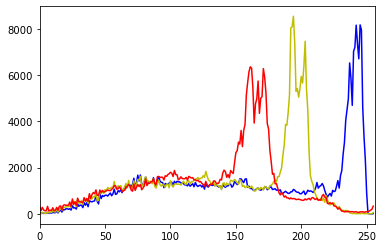

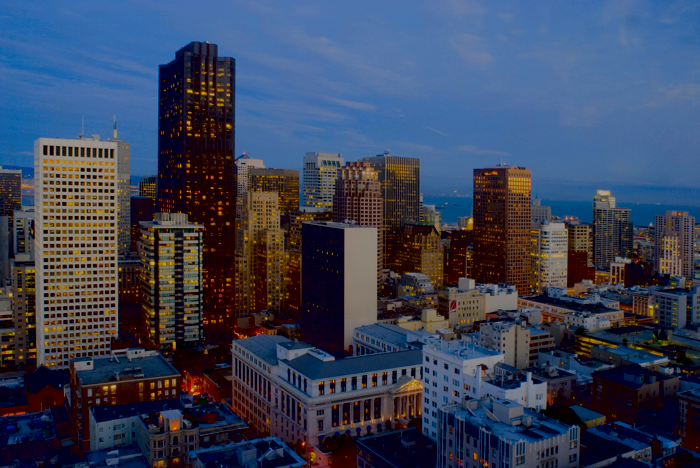

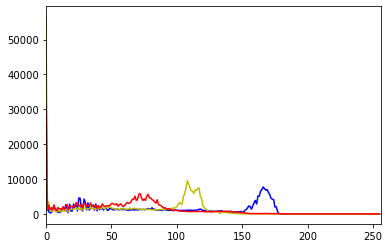

Converting picture 4...


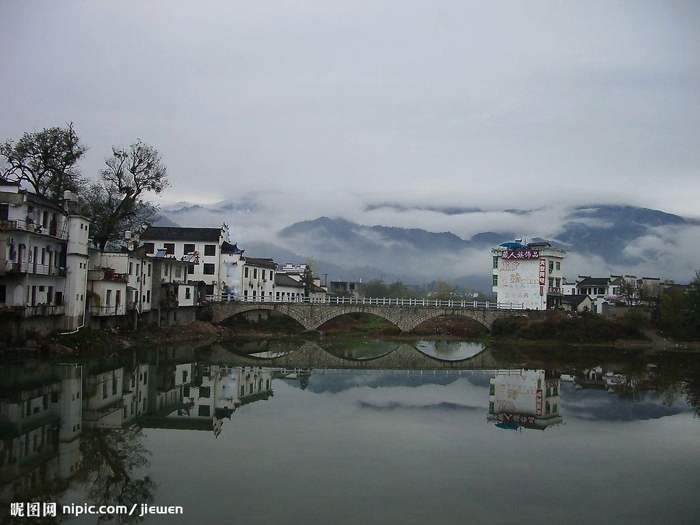

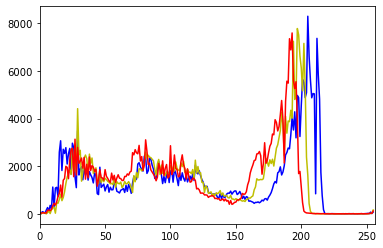

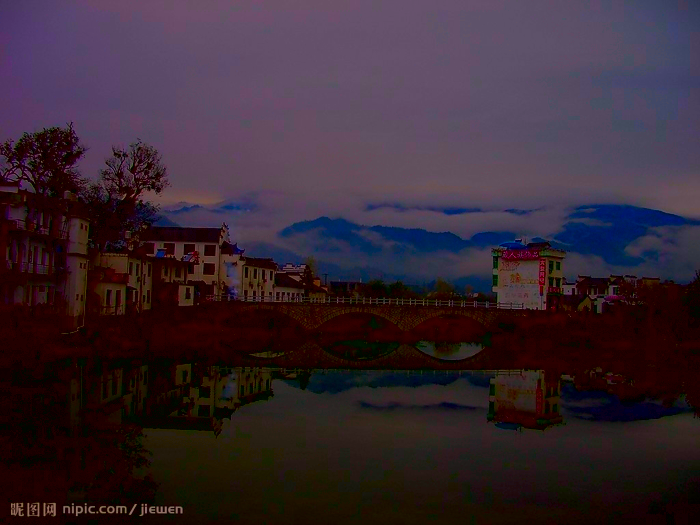

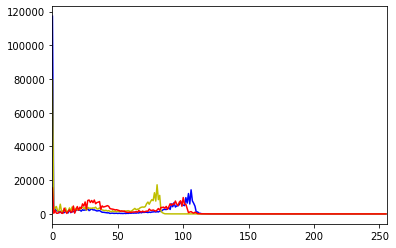

Converting picture 5...


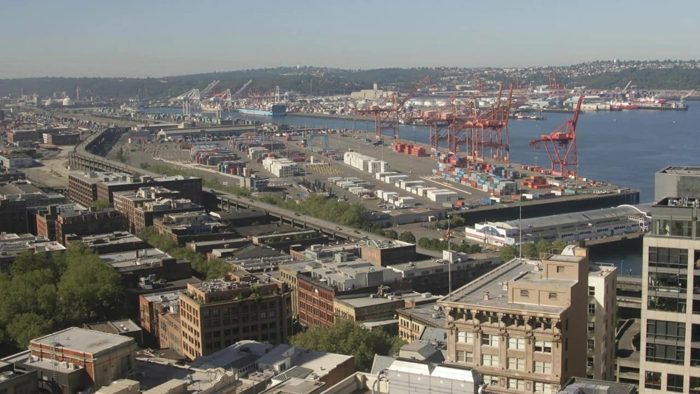

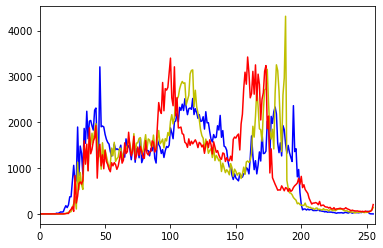

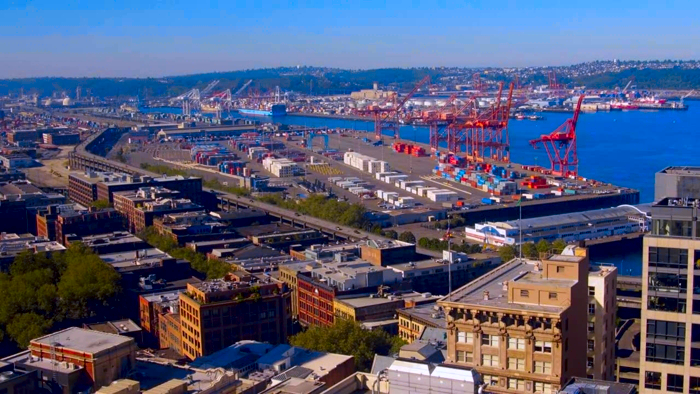

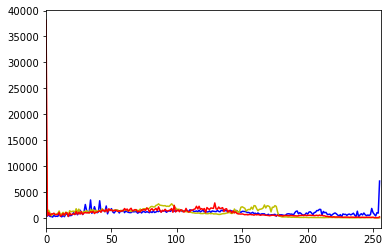

Converting picture 6...


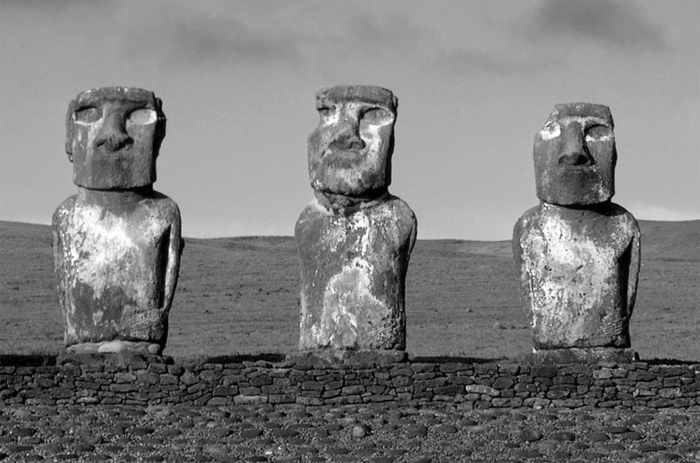

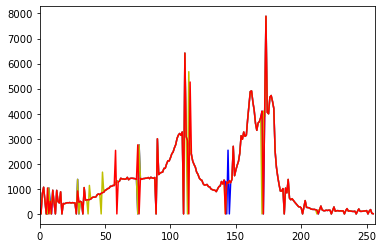

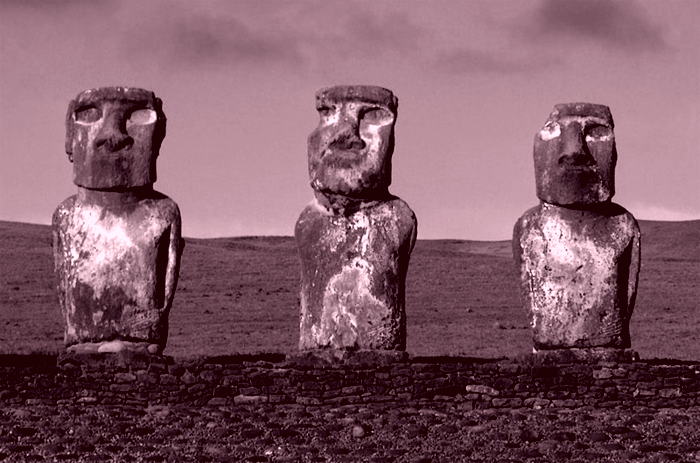

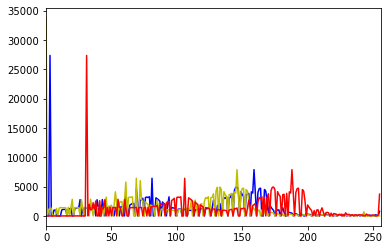

Converting picture 7...


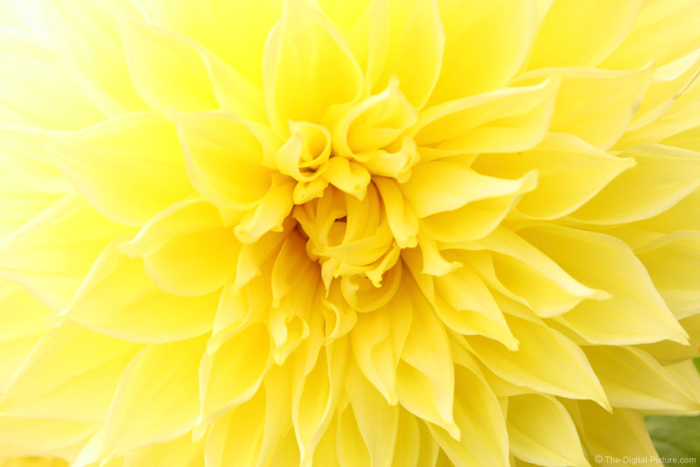

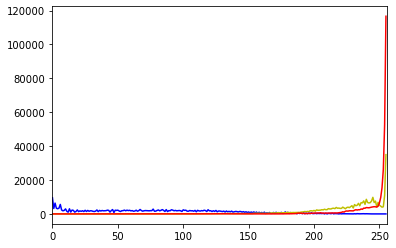

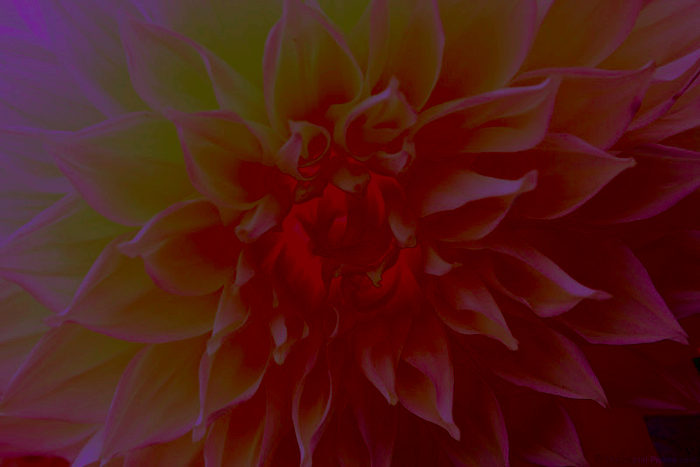

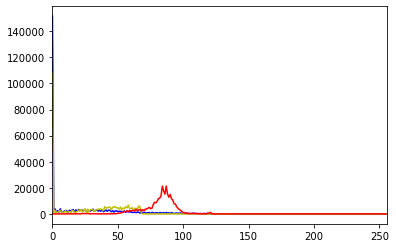

Converting picture 8...


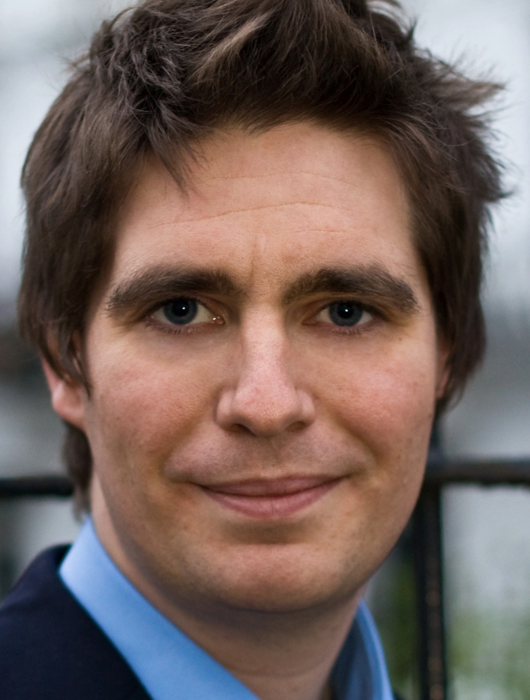

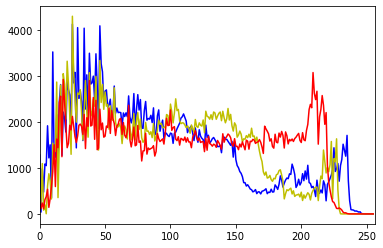

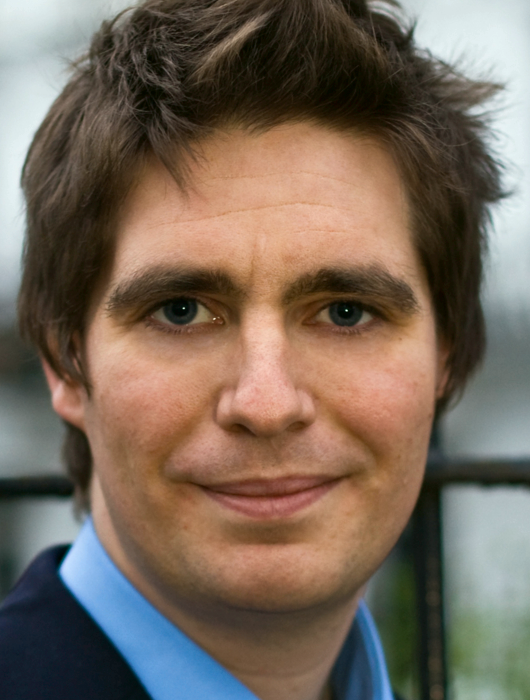

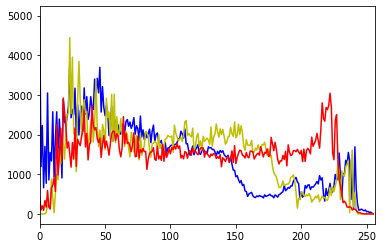

Converting picture 9...


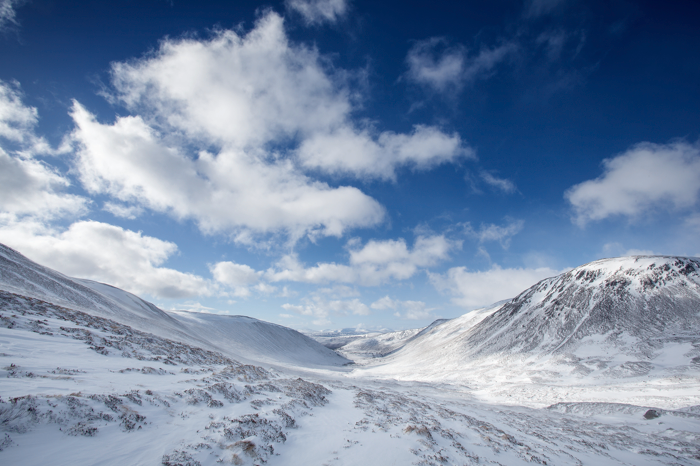

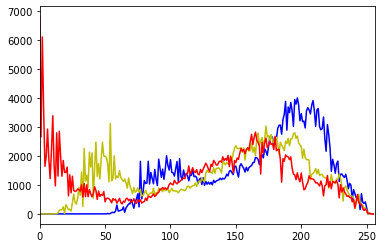

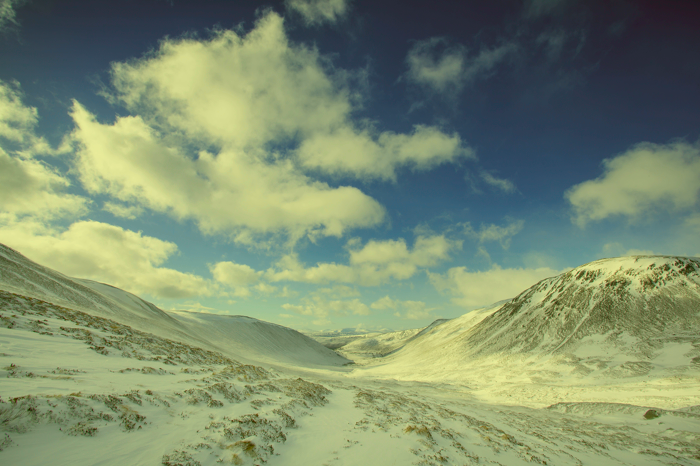

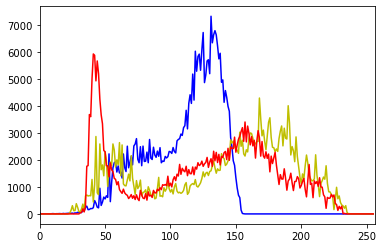

Converting picture 10...


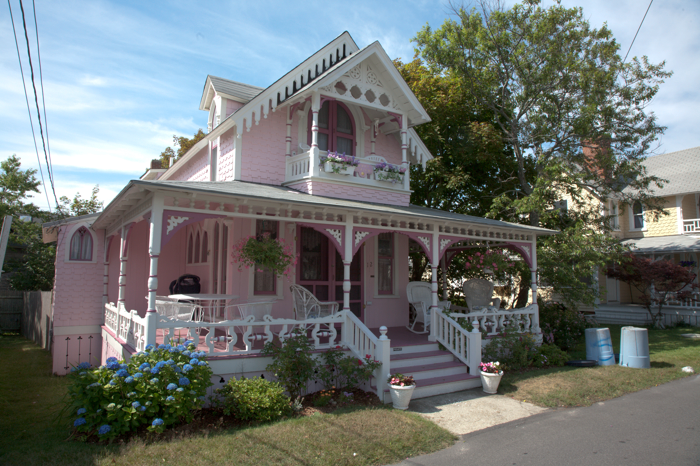

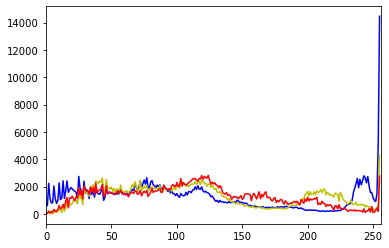

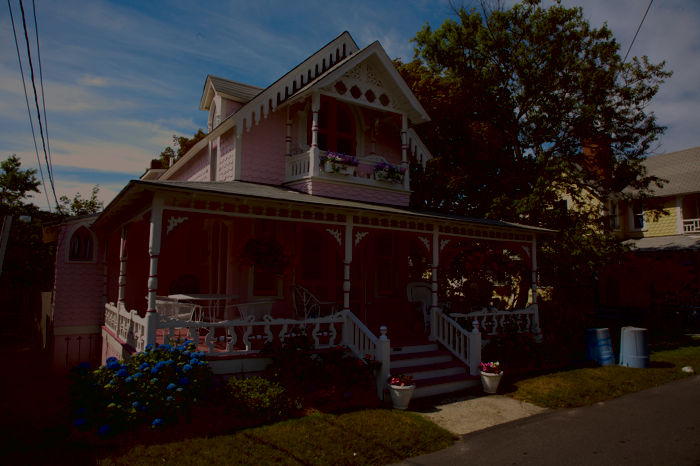

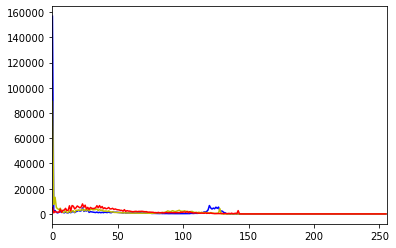

Converting picture 11...


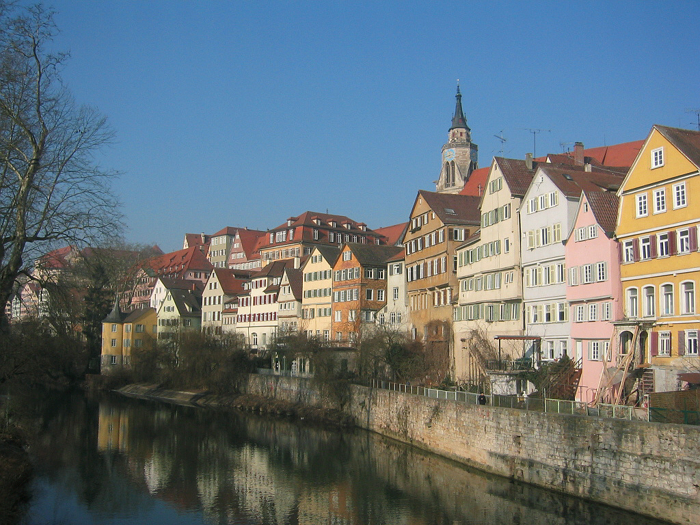

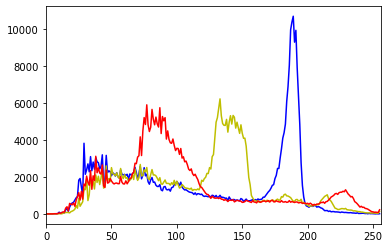

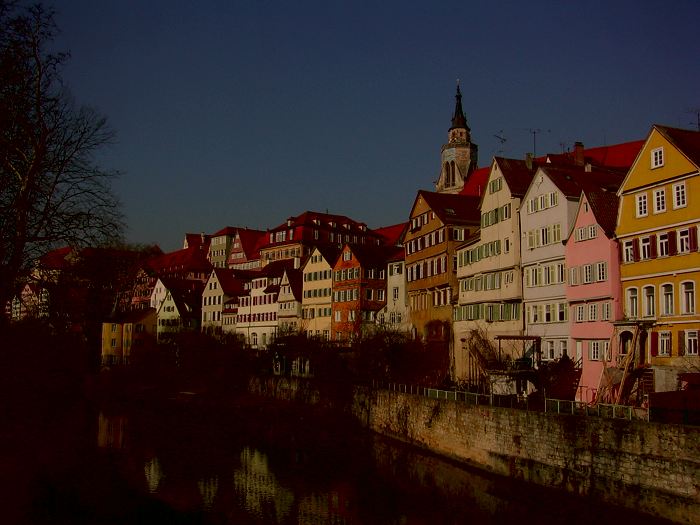

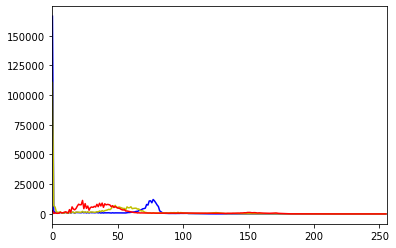

Converting picture 12...


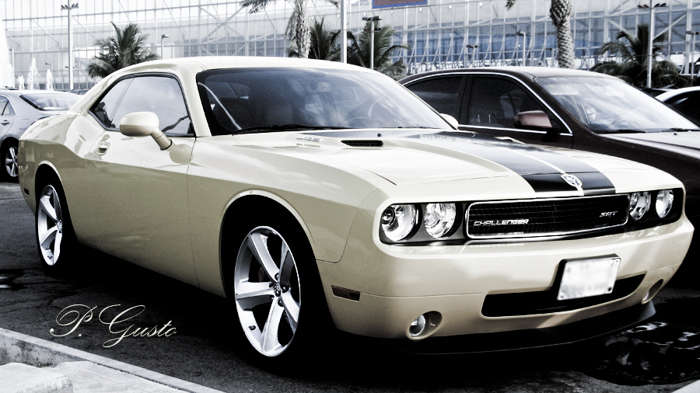

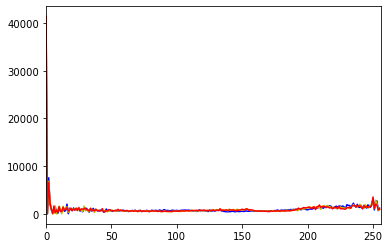

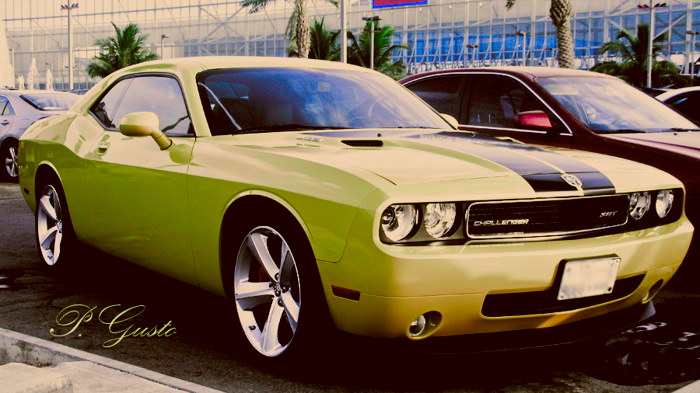

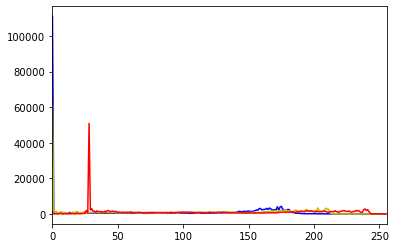

Converting picture 13...


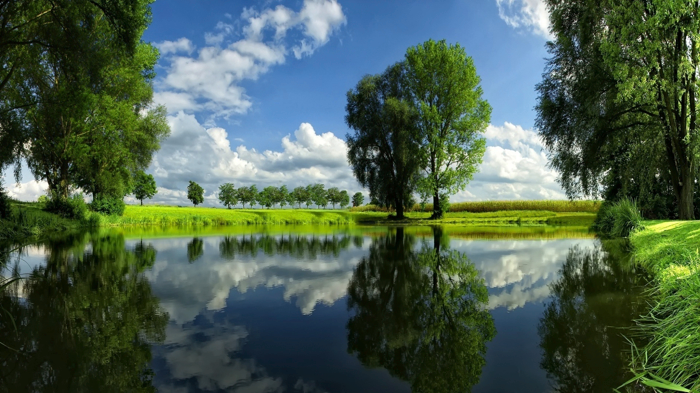

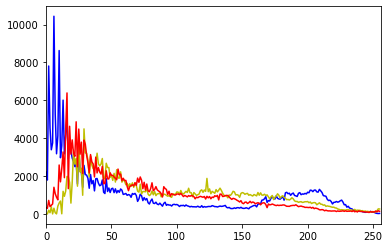

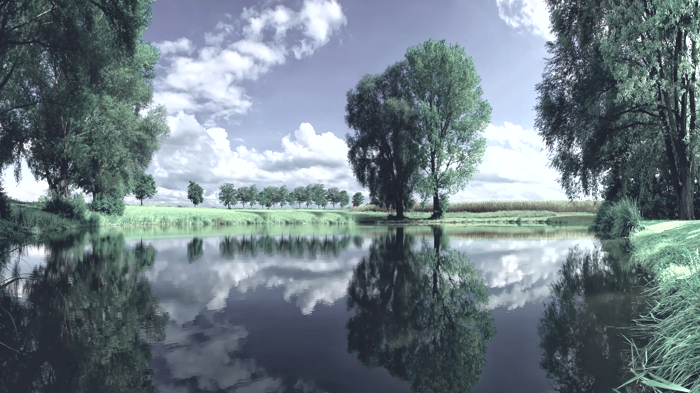

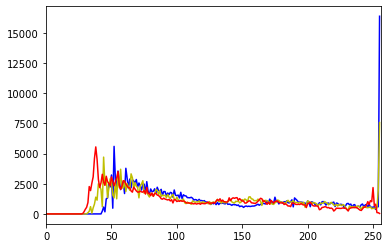

Converting picture 14...


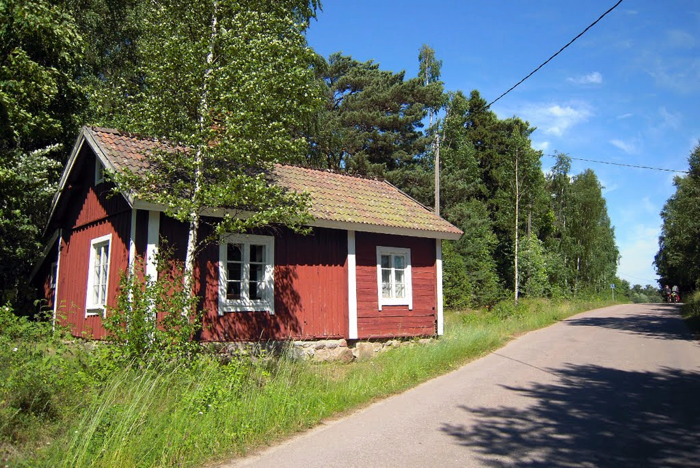

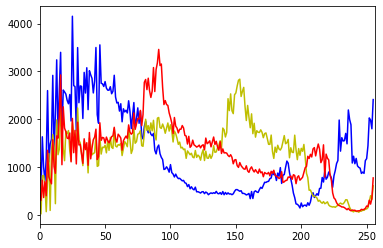

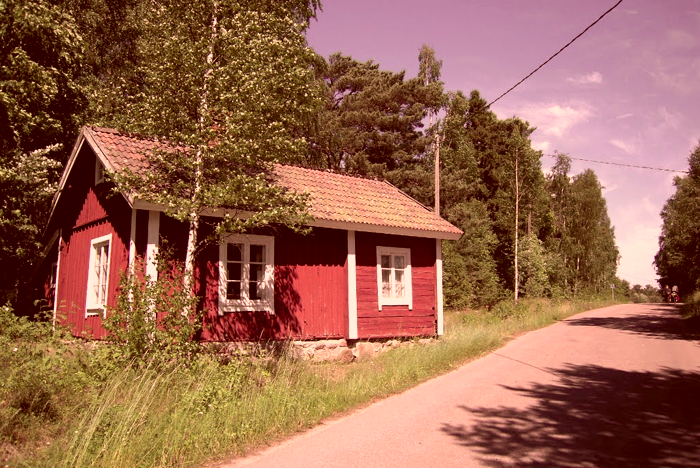

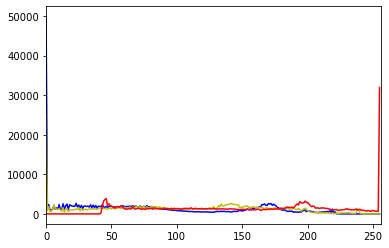

Converting picture 15...


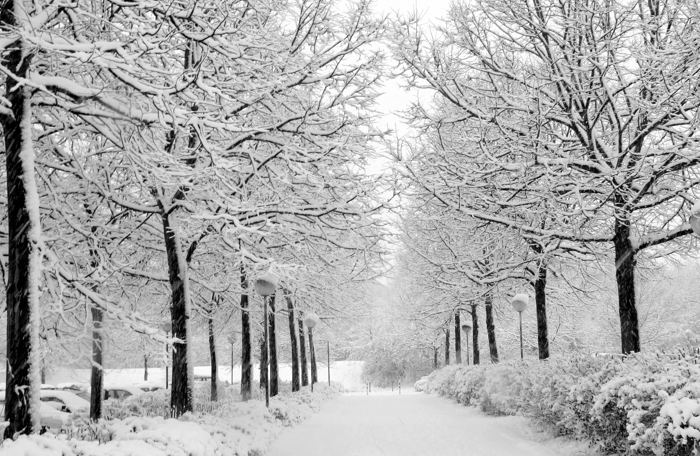

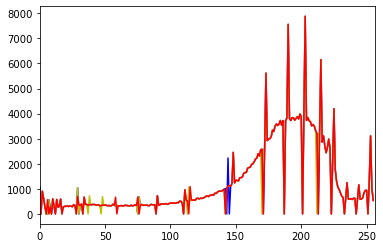

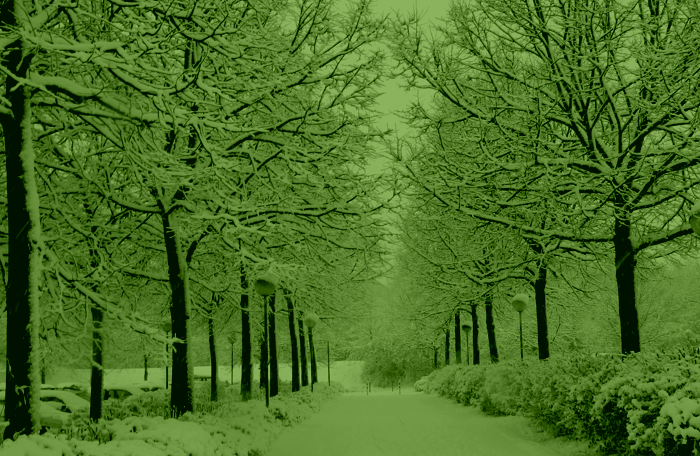

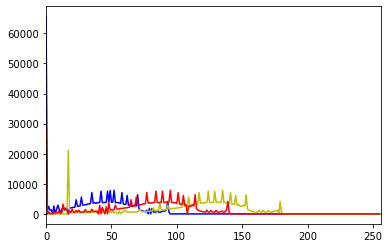

In [6]:
color_transfer()

SSD and NCC functions to calculate similarity between images

In [7]:
def calculate_ssd(img1, img2):
    # compute sum of squared differences (SSD) between two images
    if img1.shape != img2.shape:
        print("Images don't have the same shape.")
        return
    return np.sum((np.array(img1, dtype=np.float32) - np.array(img2, dtype=np.float32))**2)

In [8]:
def calculate_ncc(patch1, patch2):
    product = np.mean((patch1 - patch1.mean()) * (patch2 - patch2.mean()))
    stds = patch1.std() * patch2.std()
    if stds == 0:
        return 0
    else:
        product /= stds
        return product

Helper function to create same sized source and target image

In [9]:
def myround(pixel, base=50):
    return int(base * round(float(pixel)/base))

Color transfering between similiar regions

In [10]:
def color_transfer_blocks():
    
    for n in range(len(sources)):
        print("Converting picture "+ str(n+1) + "...")
        s, t = read_image(sources[n],targets[n])
        
        if(s.shape[1] > t.shape[1]):
            t = cv2.resize(t, (myround(t.shape[1], myround(t.shape[0]))))
            s = cv2.resize(s, (t.shape[1], t.shape[0]))
        else:
            s = cv2.resize(s, (myround(s.shape[1]), myround(s.shape[0])))
            t = cv2.resize(t, (s.shape[1], s.shape[0]))            
            
        s_tiles = s.reshape(int((s.shape[1]/50)*(s.shape[0]/50)),50,50,3)
        t_tiles = t.reshape(int((t.shape[1]/50)*(t.shape[0]/50)),50,50,3)
            
        counter = 0
        counter2 = 0
        
        for s_tile in s_tiles:

            if(counter == int(s.shape[1]/50)):
                counter = 0
                counter2 += 1
            
            scores = []
            for t_tile in t_tiles:
                
                score = calculate_ncc(s_tile, t_tile)
                scores.append(score)
                
            s_mean, s_std = get_mean_std(s_tile)
            t_mean, t_std = get_mean_std(t_tiles[np.argmax(scores)])

            height, width, channel = s_tile.shape
            for i in range(0,height):
                for j in range(0,width):
                    for k in range(0,channel):

                        point = s[i+(50*counter2),j+(50*counter),k]
                        point = ((point-s_mean[k])*(t_std[k]/(s_std[k]+0.00001)))+t_mean[k]                    
                        point = round(point)

                        if(point<0):
                            point = 0
                        elif(point>255):
                            point = 255         

                        s[i+(50*counter2),j+(50*counter),k] = point

                        

            counter += 1  
            
        s = cv2.cvtColor(s,cv2.COLOR_LAB2BGR)
        s_rgb = cv2.cvtColor(s,cv2.COLOR_BGR2RGB)
        img = Image.fromarray(s_rgb)
        display(img)
        
        #s = cv2.cvtColor(s,cv2.COLOR_LAB2BGR)
        cv2.imwrite('results_pt2/r'+str(n+1)+'.png',s)

Converting picture 1...


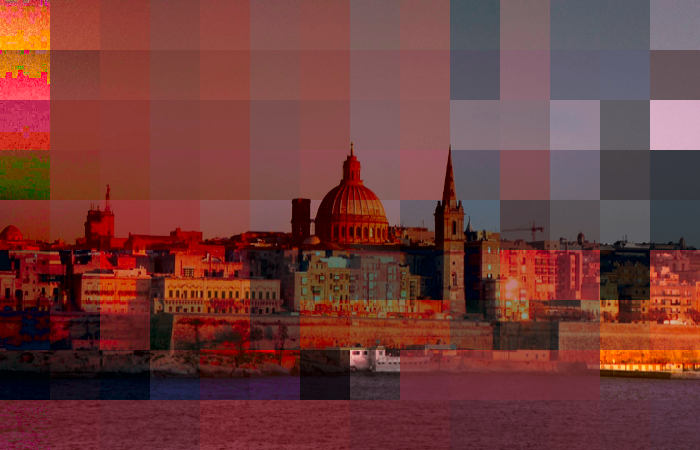

Converting picture 2...


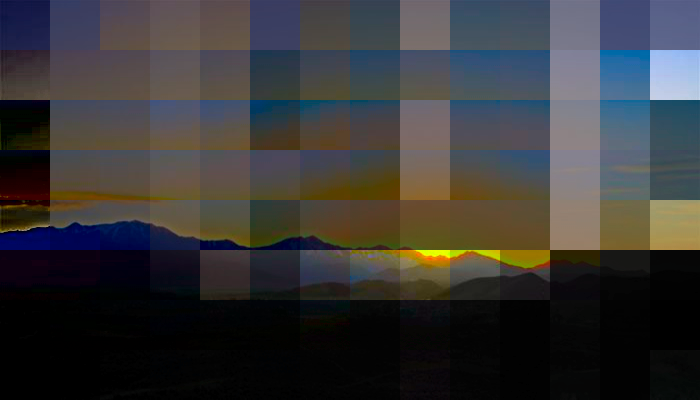

Converting picture 3...


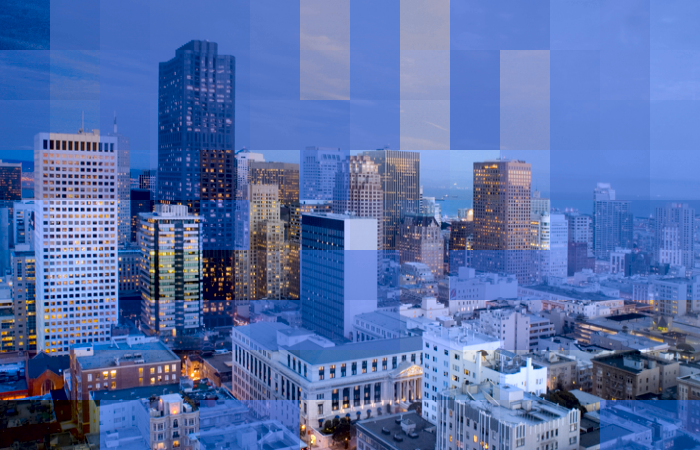

Converting picture 4...


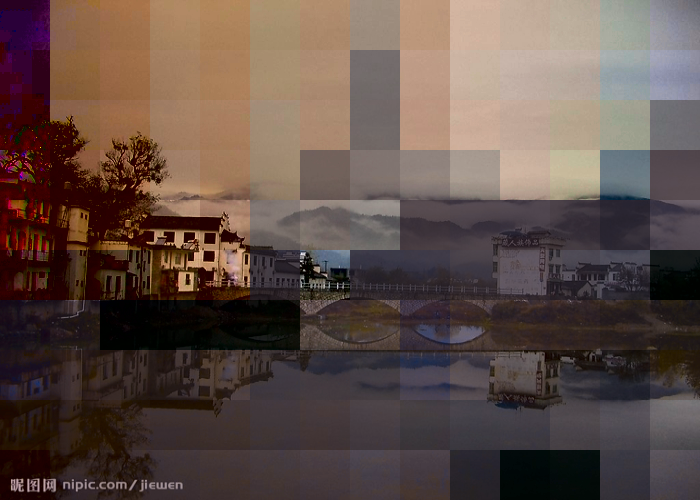

Converting picture 5...


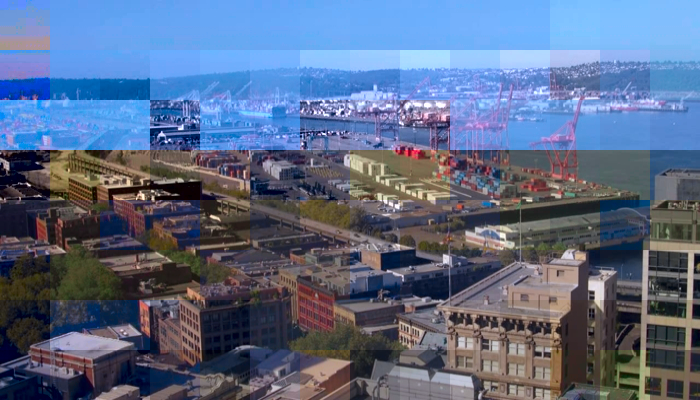

Converting picture 6...


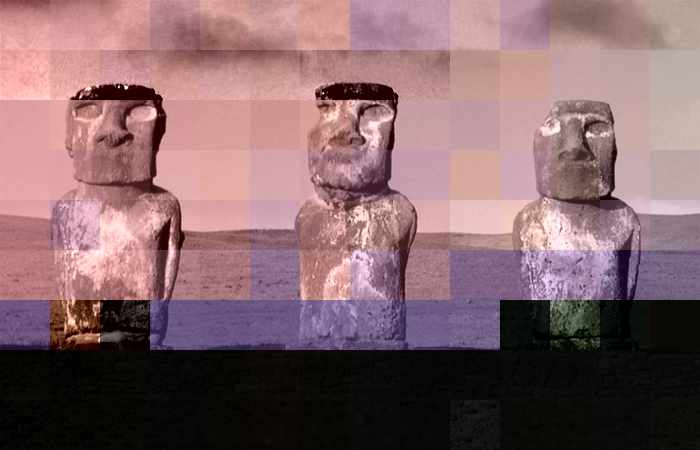

Converting picture 7...


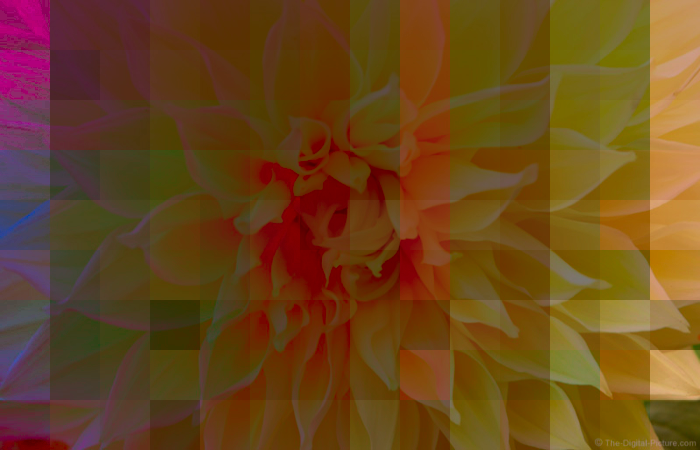

Converting picture 8...


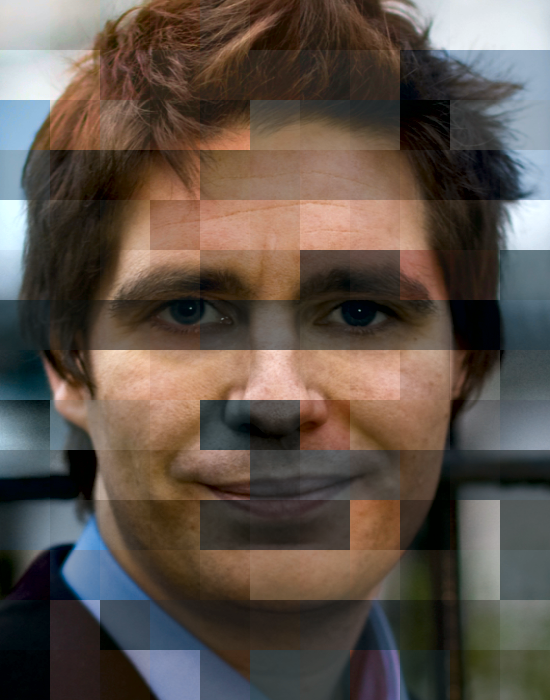

Converting picture 9...


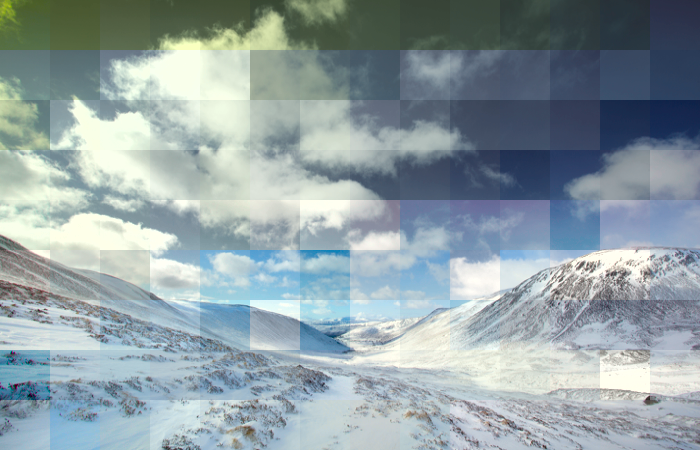

Converting picture 10...


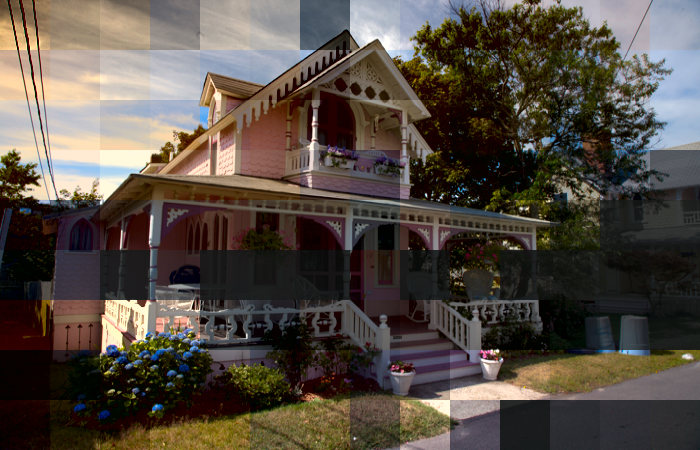

Converting picture 11...


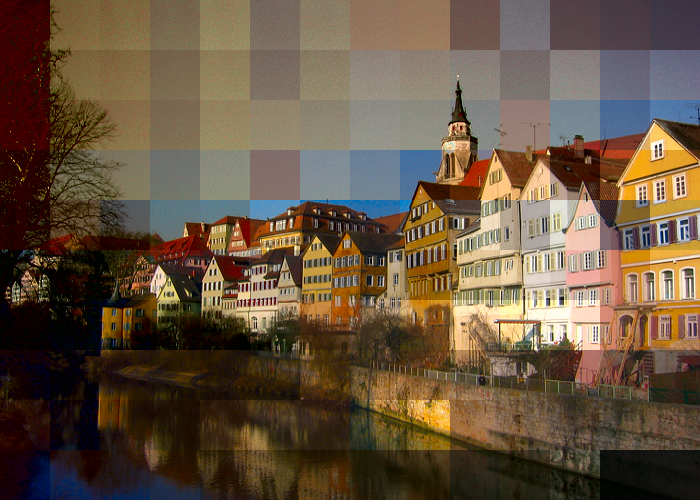

Converting picture 12...


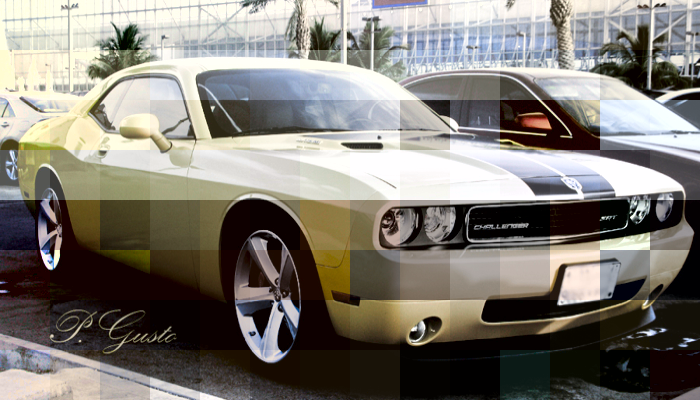

Converting picture 13...


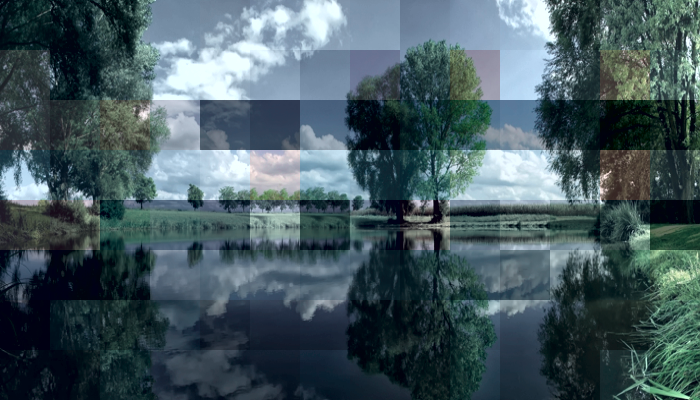

Converting picture 14...


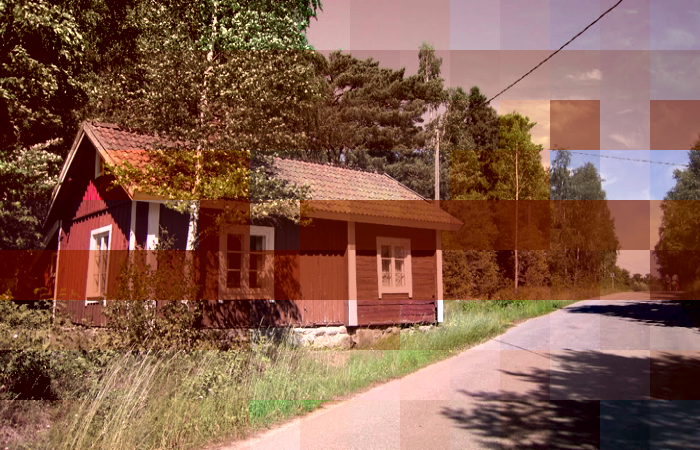

Converting picture 15...


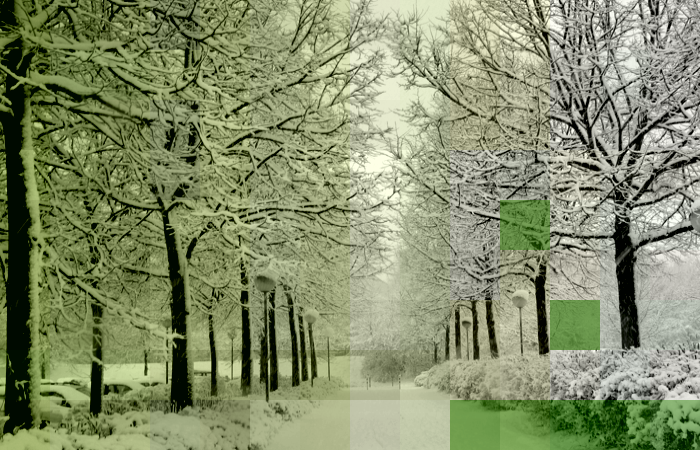

In [11]:
color_transfer_blocks()